In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import linear_model

In [90]:
df=pd.read_csv("test_scores.csv")
math=df.math.to_numpy()
cs=df.cs.to_numpy()
print(df)
model=linear_model.LinearRegression()
model.fit(df[["math"]],df[["cs"]])
print("\n")
print("R_square value is ",model.score(df[["math"]],df[["cs"]]))

     name  math  cs
0   david    92  98
1   laura    56  68
2  sanjay    88  81
3     wei    70  80
4    jeff    80  83
5   aamir    49  52
6  venkat    65  66
7   virat    35  30
8  arthur    66  68
9    paul    67  73


R_square value is  0.8990561457295679


### Gradient Descent for Linear Regression

Given data points \( (x_i, y_i) \), we want to predict \( \hat{y}_i \) using a linear model:

$$
\hat{y}_i = w \cdot x_i + b
$$

Our objective is to minimize the **Mean Squared Error (MSE)**:

$$
\text{MSE} = \frac{1}{n} \sum_{i=1}^{n} (y_i - \hat{y}_i)^2 = \frac{1}{n} \sum_{i=1}^{n} (y_i - (w x_i + b))^2
$$

We use **gradient descent** to update the parameters \( w \) (weight) and \( b \) (bias):

#### Update Rules:
Let \( \alpha \) be the **learning rate** (a hyperparameter).

We compute gradients (slopes) with respect to the loss:

$$
\frac{\partial \text{MSE}}{\partial w} = -\frac{2}{n} \sum_{i=1}^{n} x_i (y_i - \hat{y}_i)
$$

$$
\frac{\partial \text{MSE}}{\partial b} = -\frac{2}{n} \sum_{i=1}^{n} (y_i - \hat{y}_i)
$$

Then update the parameters:

$$
w := w - \alpha \cdot \frac{\partial \text{MSE}}{\partial w}
$$

$$
b := b - \alpha \cdot \frac{\partial \text{MSE}}{\partial b}
$$

Repeat until convergence (i.e., when the change in MSE becomes very small).


In [117]:
def gradient_descent(x,y,learning_rate,iterations,tol):
    weight=bias=0.0
    a=[0]
    
    for i in range(iterations):
        y_pred=weight*x+bias #y is predicted values
        mean_sq_err=(1/(len(x)))*sum((y_pred-y)**2)
        a.append(mean_sq_err)
        print("Weight: {},Bias : {}, Mean Squared Error:{}, {}".format(weight,bias,a[i+1],i))
        weight=weight-(2/len(x))*sum((y-y_pred)*(-x))*learning_rate
        bias=bias-(2/len(x))*sum((y-y_pred)*-1)*learning_rate
        if (abs(a[i+1]-a[i])<tol):
            c=i
            break
    a.pop(0)
    iter=np.arange(0,c+1)
    plt.plot(iter,a)
    plt.ylabel("Mean Squared Error")
    plt.xlabel("No of iterations")
    plt.ylim(0,100)
    plt.xlim(0,90)
    plt.title("Loss Curve")
    return weight,bias

Weight: 0.0,Bias : 0.0, Mean Squared Error:5199.1, 0
Weight: 1.9783600000000003,Bias : 0.027960000000000002, Mean Squared Error:4161.482445460163, 1
Weight: 0.20975041279999962,Bias : 0.0030470367999999894, Mean Squared Error:3332.2237319269248, 2
Weight: 1.7908456142986242,Bias : 0.025401286955264, Mean Squared Error:2669.4843523161976, 3
Weight: 0.37738163667530467,Bias : 0.005499731626422651, Mean Squared Error:2139.826383775145, 4
Weight: 1.6409848166378898,Bias : 0.023373894401807944, Mean Squared Error:1716.5264071567592, 5
Weight: 0.5113514173939655,Bias : 0.0074774305434828076, Mean Squared Error:1378.2272007804495, 6
Weight: 1.5212165764726306,Bias : 0.021771129698498662, Mean Squared Error:1107.8601808918404, 7
Weight: 0.6184191426785134,Bias : 0.009075514323270572, Mean Squared Error:891.7842215178443, 8
Weight: 1.4254981563597626,Bias : 0.020507724625171385, Mean Squared Error:719.0974036421305, 9
Weight: 0.7039868810749315,Bias : 0.010370210797388455, Mean Squared Error:58

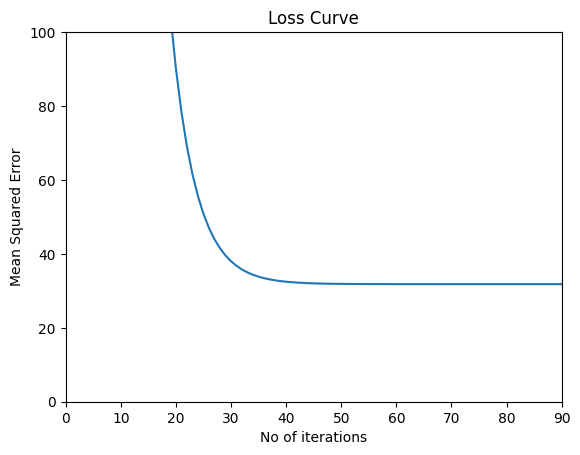

In [119]:
a,b=gradient_descent(math,cs,0.0002,1000000000,0.000000001)
print("The weight computed from scikit learn is {} and the weight from gradient descent is {}".format(model.coef_[0][0],a))
print("The bias is computed from scikit learn is {} and the bias from gradient descent is {}".format(model.intercept_[0],b))

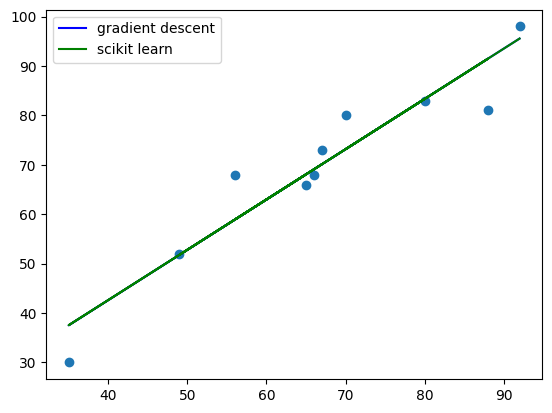

In [123]:
plt.scatter(df.math,df.cs)
y_pred=a*math+b
plt.plot(math,y_pred,"-",color="blue",label="gradient descent")
y_p=model.coef_[0][0]*math+model.intercept_[0]
plt.plot(math,y_p,"-",color="green",label="scikit learn")
plt.legend()
plt.show()